# Instruções da prova

- O único material que poderá ser consultado é este notebook, consultas à outros materiais ou à internet será considerado cola
- Renomear o notebook para C209-PV1.1-NOME_SOBRENOME_MATRICULA
- Enviar no teams a pasta com todas as mídias zipada com o nome "NOME_SOBRENOME_MATRICULA.zip"

# Parte teórica

Classifique as afirmações em Verdadeiro ou Falso, justifique as afirmativas falsas

1 - Imagens no formato RAW são bastante utilizadas por fotógrafos e tem alta taxa de compressão.

In [ ]:
# Falso, imagens no formato RAW tem taxas de compressão muito baixas.

2 - Compresão do tipo diabólica gera blocos quadrados de pixel com o mesmo valor de cor.

In [ ]:
# Verdadeiro.

3 - Compressão de dados **sem perdas** podem ser revertidos, gerando a imagem original novamente.

In [ ]:
# Verdadeiro.

4 - A primeira etapa do algoritmo JPEG consiste na conversão de espaço de cor, gerando perda de dados.

In [ ]:
# Falso, pois a conversão de espaço de cor não gera perda de dados.

5 - Áudios podem ser representados por uma matriz MxN sendo M o número de amostras e N a quantidade de bits que representam cada amostra.

In [2]:
# Falso, pois N se refere ao número de canais na saída do quantizador.

# Parte prática

## Material de apoio

### Importações

```
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt
```

### Histograma
```
def histogram_gray(img):
    (l, c) = img.shape
    # Histograma com 1 linha e 256 colunas, preenchido com 0.
    histogram = np.zeros(256, dtype=np.int32)

    for i in range(l):
        for j in range(c):
            # Normalizar intensidade do pixel 
            intensity = img[i, j]
            # Incrementar de 1 a quantidade de pixels no histograma,
            # utilizando a intensidade como índice.
            histogram[intensity] += 1
            
    return histogram

def show_histogram(img):
    histogram_r = histogram_gray(img[:, :, 0])
    histogram_g = histogram_gray(img[:, :, 1])
    histogram_b = histogram_gray(img[:, :, 2])
    
    plt.figure(figsize=(16, 16))
    plt.subplot(2, 1, 1)
    plt.bar(range(256), histogram_r, color='red')
    plt.bar(range(256), histogram_g, color='green')
    plt.bar(range(256), histogram_b, color='blue')

```

### Manipulação de imagens

```
(l,c,p) = img.shape
plt.imshow(imagem)
```

### Forçando uma imagem de uma página para 3 páginas
```
  imagem_3p = np.zeros(shape=(l,c,p),dtype=np.uint8)
  imagem_3p[:,:, 0] = frame_1p
  imagem_3p[:,:, 1] = frame_1p
  imagem_3p[:,:, 2] = frame_1p
```

### Detecção de bordas
```
    imagem_grey = np.average(frame, axis=2).astype(np.float64)
   
    abs_tg_c = np.abs(np.diff(imagem_grey.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(imagem_grey.astype(np.float64), axis=1, append=255))
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    imagem_border = np.zeros(shape=(l, c), dtype=np.uint8)
    imagem_border[abs_tg > threshold] = 255
```

### Manipulação de vídeo
```
video = mpe.VideoFileClip("video.mp4")
frame = video.get_frame(2 / video.fps)
frame = video.get_frame(2)
video.ipython_display(width=480)
video_modificado = video.fl_image(func_modificar)
subclip = video.subclip(0,2)
subclip = video.subclip(3)
parts = mpe.concatenate_videoclips([part1, part])
video.write_videofile('video.mp4')
```

### Conversão para CMY
```
img_cmy = 255 - img_rgb
```

### Greyscale

#### Opção 1 - Com numpy (recomendado) 
```
imagem_grey = np.average(frame, axis=2).astype(np.float64)
```

#### Opção 2 - Algoritmo genérico, substituir o método escolhido
```
img_avg = np.zeros(shape=(l, c), dtype=np.uint8)
for i in range(l):
    for j in range(c):
        r = float(img_np[i, j, 0])
        g = float(img_np[i, j, 1])
        b = float(img_np[i, j, 2])
        
        img_avg[i, j] = (aplicar método)
```

#### Métodos: 

Lightness: $\frac{max(R,G,B)+min(R,G,B)}{2}$

Average: $\frac{R+G+B}{3}$

Luminosity: $0.2126 \cdot R + 0.7152 \cdot G + 0.0722 \cdot B$


**1 -** Importe as bibliotecas que serão usadas

In [2]:
import moviepy.editor as mpe
import numpy as np
import matplotlib.pyplot as plt

**2 -** Abra o vídeo "bigbuckbunny.mp4" e salve-o em uma variável, pegue o frame de índice 5 e o exiba.

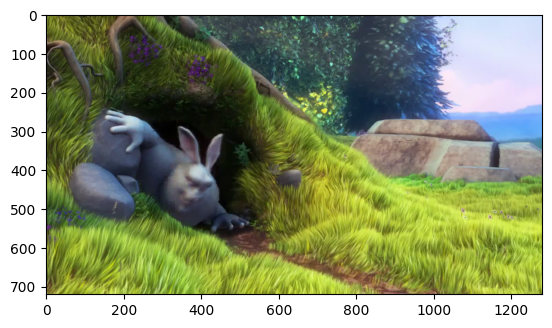

In [6]:
video = mpe.VideoFileClip("bigbuckbunny.mp4")

frame = video.get_frame(5 / video.fps)

plt.imshow(frame)

**3 -** Exiba o histograma RGB do frame selecionado.

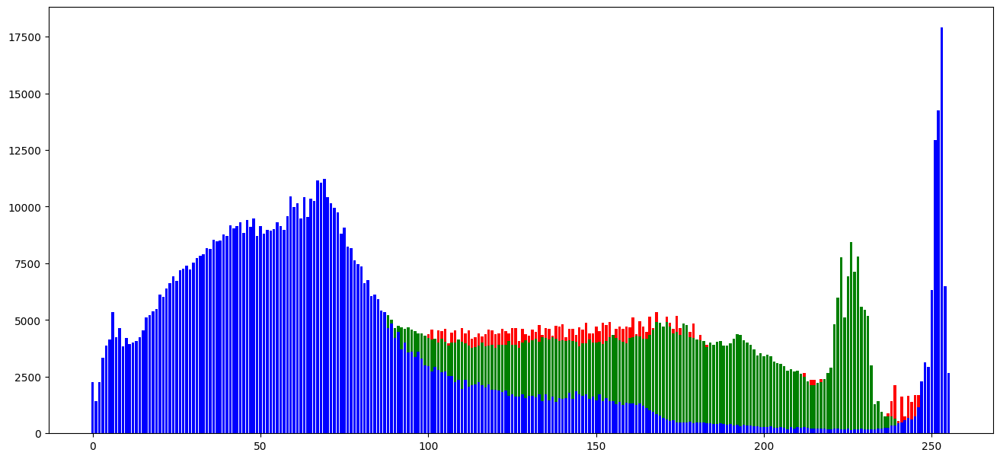

In [7]:
def histogram_gray(img):
    (l, c) = img.shape
    # Histograma com 1 linha e 256 colunas, preenchido com 0.
    histogram = np.zeros(256, dtype=np.int32)

    for i in range(l):
        for j in range(c):
            # Normalizar intensidade do pixel 
            intensity = img[i, j]
            # Incrementar de 1 a quantidade de pixels no histograma,
            # utilizando a intensidade como índice.
            histogram[intensity] += 1
            
    return histogram

def show_histogram(img):
    histogram_r = histogram_gray(img[:, :, 0])
    histogram_g = histogram_gray(img[:, :, 1])
    histogram_b = histogram_gray(img[:, :, 2])
    
    plt.figure(figsize=(16, 16))
    plt.subplot(2, 1, 1)
    plt.bar(range(256), histogram_r, color='red')
    plt.bar(range(256), histogram_g, color='green')
    plt.bar(range(256), histogram_b, color='blue')
    
show_histogram(frame)

**4 -** Crie uma função que receba um frame e retorne um frame em preto e branco, **sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [8]:
def frame_preto_branco(frame): 
    # Obtém as dimensões do quadro de entrada
    (l, c, p) = frame.shape  # l = número de linhas, c = número de colunas, p = número de canais de cor (normalmente 3 para RGB)
    
    # Converte o quadro para escala de cinza calculando a média ao longo do eixo 2 (canais de cor)
    frame_bw = np.average(frame, axis=2).astype(np.float64)
    
    # Cria um novo quadro com três canais (RGB) utilizando o quadro em escala de cinza
    frame_3p = np.zeros(shape=(l, c, p), dtype=np.uint8)
    frame_3p[:, :, 0] = frame_bw  # Canal vermelho recebe a escala de cinza
    frame_3p[:, :, 1] = frame_bw  # Canal verde recebe a escala de cinza
    frame_3p[:, :, 2] = frame_bw  # Canal azul recebe a escala de cinza
    
    return frame_3p

video_preto_branco = video.fl_image(frame_preto_branco)

video_preto_branco.ipython_display(width=480)


Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**5 -** Crie uma função que receba um frame e realize a detecção de bordas nele com treshold de valor 16, **sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [9]:
def deteccao_bordas(frame):
    # Extrai as dimensões do frame (altura l, largura c, canais p)
    (l, c, p) = frame.shape
    
    # Converte o frame para escala de cinza pela média dos canais
    frame_bw = np.average(frame, axis=2).astype(np.float64)
    
    # Calcula as diferenças absolutas nas direções vertical e horizontal
    abs_tg_c = np.abs(np.diff(frame_bw.astype(np.float64), axis=0, append=255))
    abs_tg_l = np.abs(np.diff(frame_bw.astype(np.float64), axis=1, append=255))
    
    # Calcula o magnitude do gradiente
    abs_tg = np.sqrt(abs_tg_c ** 2 + abs_tg_l ** 2)

    # Define um limiar para detectar as bordas
    threshold = 16
    frame_border = np.zeros(shape=(l, c), dtype=np.uint8)
    
    # Cria uma imagem binária onde as bordas são marcadas com branco (255)
    frame_border[abs_tg > threshold] = 255
    
    # Cria um frame de 3 canais para propósitos de visualização
    frame_3p = np.zeros(shape=(l, c, p), dtype=np.uint8)
    
    # Atribui as bordas detectadas a todos os canais (R, G, B)
    frame_3p[:, :, 0] = frame_border
    frame_3p[:, :, 1] = frame_border
    frame_3p[:, :, 2] = frame_border
    
    return frame_3p

video_border = video.fl_image(deteccao_bordas)

video_border.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**6 -** Crie uma função que receba um frame e realize a conversão dele para o espaço de cor cmy, **sua função deve retornar um frame com 3 páginas para evitar problemas**.

In [10]:
# Calcula o complemento CMY de cada pixel no frame
def convert_cmy(frame):
    cmy = 255 -frame
    return cmy

video_cmy = video.fl_image(convert_cmy)

video_cmy.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**7 -** Separe o vídeo original em 3 subclips:
- Segundos 0 ao 2: Aplicar detecção de bordas
- Segundos 2 ao 4: Aplicar conversão para cmy
- Segundos 4 em diante: Aplicar conversão para escala de cinza

**Una esses clips em um único vídeo e exiba o resultado.**

In [11]:
# Aplicar detecção de bordas
part1 = video.subclip(0,2).fl_image(deteccao_bordas)

# Aplicar conversão para cmy
part2 = video.subclip(2,4).fl_image(convert_cmy)

# Aplicar conversão para escala de cinza
part3 = video.subclip(4).fl_image(frame_preto_branco)

# Concatenar ambas partes para gerar um único vídeo
parts = mpe.concatenate_videoclips([part1, part2, part3])

parts.ipython_display(width=480)

Moviepy - Building video __temp__.mp4.
MoviePy - Writing audio in __temp__TEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


**8 -** Salve o vídeo resultante da última etapa com o nome "resultado.mp4".

In [12]:
parts.write_videofile('resultado.mp4')

Moviepy - Building video resultado.mp4.
MoviePy - Writing audio in resultadoTEMP_MPY_wvf_snd.mp3


MoviePy - Done.
Moviepy - Writing video resultado.mp4



Moviepy - Done !
Moviepy - video ready resultado.mp4
